Name: Masroor Fattah Bin Hossain
Student Id: 45765758

In [2]:
import pandas as pd
from matplotlib import pyplot as plt
from datetime import timedelta
plt.style.use('seaborn')
%matplotlib inline

# Analysis of Cycling Data

## Loading Data

The first dataset is an export of my ride data from [Strava](https://strava.com/), an online social 
network site for cycling and other sports.  This data is a log of every ride since the start of 2018
and contains summary data like the distance and average speed.  It was exported using 
the script `stravaget.py` which uses the stravalib module to read data. Some details of
the fields exported by that script can be seen in [the documentation for stravalib](https://pythonhosted.org/stravalib/api.html#stravalib.model.Activity). 

The exported data is a CSV file so that's easy to read, however the date information in the file is 
recorded in a different timezone (UTC) so we need to do a bit of conversion.  In reading the data I'm
setting the index of the data frame to be the datetime of the ride. 

In [3]:
strava = pd.read_csv('data/strava_export.csv', index_col='date', parse_dates=True)
strava.index = strava.index.tz_convert('UTC')
strava.head()

,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type
date,,,,,,,,,,
2018-01-02 20:47:51+00:00,100.6,21.0,73.8,False,15.2,94,316.00 m,10,73,Ride
2018-01-04 01:36:53+00:00,NaN,24.0,131.7,False,18.0,52,236.00 m,5,46,Ride
2018-01-04 02:56:00+00:00,83.1,25.0,13.8,False,0.0,3,0.00 m,2,2,Ride
2018-01-04 05:37:04+00:00,110.1,24.0,113.6,False,22.9,77,246.00 m,8,64,Ride
2018-01-05 19:22:46+00:00,110.9,20.0,147.7,True,58.4,189,676.00 m,12,144,Ride


The second dataset comes from an application called [GoldenCheetah](https://www.goldencheetah.org/) which provides
some analytics services over ride data.  This has some of the same fields but adds a lot of analysis of the 
power, speed and heart rate data in each ride.  This data overlaps with the Strava data but doesn't include all 
of the same rides. 

Again we create an index using the datetime for each ride, this time combining two columns in the data (date and time) 
and localising to Sydney so that the times match those for the Strava data. 

In [4]:
cheetah = pd.read_csv('data/cheetah.csv', skipinitialspace=True)
cheetah.index = pd.to_datetime(cheetah['date'] + ' ' + cheetah['time'])
cheetah.index = cheetah.index.tz_localize('Australia/Sydney')
cheetah.head()

,date,time,filename,axPower,aPower Relative Intensity,aBikeScore,Skiba aVI,aPower Response Index,aIsoPower,aIF,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-01-28 06:39:49+11:00,01/28/18,06:39:49,2018_01_28_06_39_49.json,202.211,0.75452,16.6520,1.31920,1.67755,223.621,0.83441,...,0,0,0,0,0,0,0,222.856,0.83155,20.2257
2018-01-28 07:01:32+11:00,01/28/18,07:01:32,2018_01_28_07_01_32.json,226.039,0.84343,80.2669,1.21137,1.54250,246.185,0.91860,...,0,0,0,0,0,0,0,245.365,0.91554,94.5787
2018-02-01 08:13:34+11:00,02/01/18,08:13:34,2018_02_01_08_13_34.json,0.000,0.00000,0.0000,0.00000,0.00000,0.000,0.00000,...,0,0,0,0,0,0,0,0.000,0.00000,0.0000
2018-02-06 08:06:42+11:00,02/06/18,08:06:42,2018_02_06_08_06_42.json,221.672,0.82714,78.8866,1.35775,1.86002,254.409,0.94929,...,0,0,0,0,0,0,0,253.702,0.94665,98.3269
2018-02-07 17:59:05+11:00,02/07/18,17:59:05,2018_02_07_17_59_05.json,218.211,0.81422,159.4590,1.47188,1.74658,233.780,0.87231,...,0,0,0,0,0,0,0,232.644,0.86808,171.0780


The GoldenCheetah data contains many many variables (columns) and I won't go into all of them here. Some
that are of particular interest for the analysis below are:

Here are definitions of some of the more important fields in the data. Capitalised fields come from the GoldenCheetah data
while lowercase_fields come from Strava. There are many cases where fields are duplicated and in this case the values
should be the same, although there is room for variation as the algorithm used to calculate them could be different
in each case. 

  * Duration - overall duration of the ride, should be same as elapsed_time
  * Time Moving - time spent moving (not resting or waiting at lights), should be the same as moving_time
  * Elevation Gain - metres climbed over the ride
  * Average Speed - over the ride
  * Average Power - average power in watts as measured by a power meter, relates to how much effort is being put in to the ride, should be the same as  * average_watts' from Strava
  * Nonzero Average Power - same as Average Power but excludes times when power is zero from the average
  * Average Heart Rate - should be the same as average_heartrate
  * Average Cadence - cadence is the rotations per minute of the pedals
  * Average Temp - temperature in the environment as measured by the bike computer (should be same as average_temp)
  * VAM - average ascent speed - speed up hills
  * Calories (HR) - Calorie expendature as estimated from heart rate data
  * 1 sec Peak Power - this and other  'Peak Power' measures give the maximum power output in the ride over this time period.  Will be higher for shorter periods. High values in short periods would come from a very 'punchy' ride with sprints for example.
  * 1 min Peak Hr - a similar measure relating to Heart Rate
  * NP - Normalised Power, a smoothed average power measurement, generally higher than Average Power 
  * TSS - Training Stress Score, a measure of how hard a ride this was
  * device_watts - True if the power (watts) measures were from a power meter, False if they were estimated
  * distance - distance travelled in Km
  * kudos - likes from other Strava users (social network)
  * workout_type - one of  'Race',  'Workout' or  'Ride'
  
  
Some of the GoldenCheetah parameters are defined [in thier documentation](https://github.com/GoldenCheetah/GoldenCheetah/wiki/UG_Glossary).  

## Your Tasks

Your first task is to combine these two data frames using the [`join` method of Pandas](https://pandas.pydata.org/pandas-docs/stable/user_guide/merging.html#joining-on-index).   The goal is to keep only those rows of data 
that appear in __both__ data frames so that we have complete data for every row.  

In [5]:
result = strava.join(cheetah,how='inner')
result.head()



,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-01-27 19:39:49+00:00,120.6,21.0,153.4,True,7.6,17,95.00 m,4,17,Ride,...,0,0,0,0,0,0,0,222.856,0.83155,20.2257
2018-01-27 20:01:32+00:00,146.9,22.0,187.7,True,38.6,67,449.00 m,19,67,Race,...,0,0,0,0,0,0,0,245.365,0.91554,94.5787
2018-01-31 21:13:34+00:00,109.8,19.0,143.0,False,26.3,649,612.00 m,6,113,Ride,...,0,0,0,0,0,0,0,0.000,0.00000,0.0000
2018-02-05 21:06:42+00:00,119.3,19.0,165.9,True,24.3,69,439.00 m,6,65,Ride,...,0,0,0,0,0,0,0,253.702,0.94665,98.3269
2018-02-07 06:59:05+00:00,124.8,20.0,151.0,True,47.1,144,890.00 m,10,134,Ride,...,0,0,0,0,0,0,0,232.644,0.86808,171.0780


## Required Analysis

1. Remove rides with no measured power (where device_watts is False) - these are commutes or MTB rides
* Look at the distributions of some key variables: time, distance, average speed, average power, TSS. Are they normally distributed? Skewed? 
* Explore the relationships between the following variables. Are any of them corrolated with each other (do they vary together in a predictable way)? Can you explain any relationships you observe?  
    * Distance
    * Moving Time
    * Average Speed
    * Heart Rate
    * Power (watts)
    * Normalised power (NP)
    * Training Stress Score
    * Elevation Gain
* We want to explore the differences between the three categories: `Race`, `Workout` and `Ride`.
    * Use scatter plots with different colours for each category to explore how these categories differ.  
    * Use histograms or box plots to visualise the different distributions of a variable for the three categories.
    * In both cases, experiment with different variables but only include those that are interesting in your final notebook (if none are interesting, show us a representative example).


## Challenge

* What leads to more `kudos`? Is there anything to indicate which rides are more popular? Explore the relationship between the main variables and kudos. Show a plot and comment on any relationship you observe. 

* Generate a plot that summarises the number of km ridden each month over the period of the data. Overlay this with the _sum_ of the Training Stress Score and the _average_ of the Average Speed to generate an overall summary of activity.

* Generate a similar graph but one that shows the activity over a given month, with the sum of the values for each day of the month shown.  So, if there are two rides on a given day, the graph should show the sum of the distances etc for these rides.

Hint: to generate these summary plots you need to use the [timeseries/date functionality](https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html) in Pandas to generate a new data frame containing the required data.  

__Note:__ once you have completed these steps you can remove this cell.  Use the text as a starting point for the documentation of your workflow and discussion of results.


In [6]:
df2 = result.drop(result.index[
                      (result['device_watts'] ==False)
])
df2.head()

,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-01-27 19:39:49+00:00,120.6,21.0,153.4,True,7.6,17,95.00 m,4,17,Ride,...,0,0,0,0,0,0,0,222.856,0.83155,20.2257
2018-01-27 20:01:32+00:00,146.9,22.0,187.7,True,38.6,67,449.00 m,19,67,Race,...,0,0,0,0,0,0,0,245.365,0.91554,94.5787
2018-02-05 21:06:42+00:00,119.3,19.0,165.9,True,24.3,69,439.00 m,6,65,Ride,...,0,0,0,0,0,0,0,253.702,0.94665,98.3269
2018-02-07 06:59:05+00:00,124.8,20.0,151.0,True,47.1,144,890.00 m,10,134,Ride,...,0,0,0,0,0,0,0,232.644,0.86808,171.0780
2018-02-09 19:18:03+00:00,123.0,20.0,145.9,True,59.8,193,656.00 m,22,139,Ride,...,0,0,0,0,0,0,0,212.726,0.79375,147.7970


(array([18., 25., 17., 39., 15., 14.,  4.,  6.,  0.,  3.,  4.,  2.,  3.,
         9., 22., 14.,  4.,  4.,  2.,  4.]),
 array([ 13.  ,  25.35,  37.7 ,  50.05,  62.4 ,  74.75,  87.1 ,  99.45,
        111.8 , 124.15, 136.5 , 148.85, 161.2 , 173.55, 185.9 , 198.25,
        210.6 , 222.95, 235.3 , 247.65, 260.  ]),
 <a list of 20 Patch objects>)

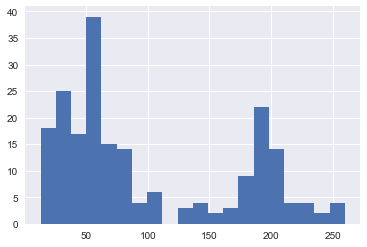

In [7]:
plt.hist(df2['elapsed_time'],bins=20)

It is related to binomial distribution. It is neither right skewed or left skewed.

(array([14., 29.,  4., 29., 35., 15.,  5.,  7.,  1.,  1., 13., 30., 10.,
         5.,  2.,  4.,  3.,  1.,  0.,  1.]),
 array([ 10. ,  21.3,  32.6,  43.9,  55.2,  66.5,  77.8,  89.1, 100.4,
        111.7, 123. , 134.3, 145.6, 156.9, 168.2, 179.5, 190.8, 202.1,
        213.4, 224.7, 236. ]),
 <a list of 20 Patch objects>)

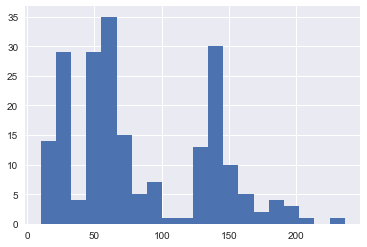

In [8]:
plt.hist(df2['moving_time'],bins=20)

It is neither right skewed nor left skewed. It is related to binomial distribution

(array([10., 25., 15., 14., 23., 24., 18.,  8.,  8.,  5., 23., 25.,  4.,
         1.,  3.,  1.,  0.,  0.,  0.,  2.]),
 array([  0.  ,   5.41,  10.82,  16.23,  21.64,  27.05,  32.46,  37.87,
         43.28,  48.69,  54.1 ,  59.51,  64.92,  70.33,  75.74,  81.15,
         86.56,  91.97,  97.38, 102.79, 108.2 ]),
 <a list of 20 Patch objects>)

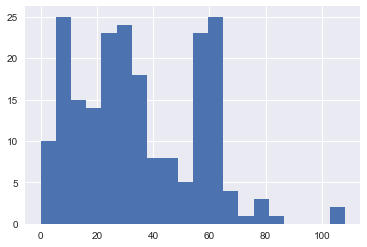

In [39]:
plt.hist(df2['distance'],bins=20)

# Interpretation 
The distance is left skewed as there are more points to the left of the mean

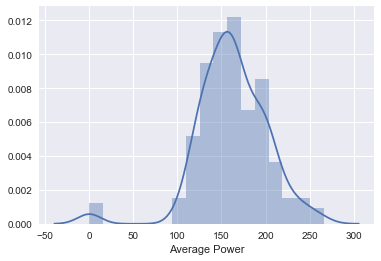

In [26]:
import seaborn as sb
sb.distplot(df2['Average Power'])

The graph above is normally distributed.

(array([ 3.,  2.,  0.,  0.,  0.,  0.,  0.,  2.,  7., 10., 27., 39., 56.,
        21., 10.,  4.,  4.,  8., 13.,  3.]),
 array([ 3.67233  ,  5.4062235,  7.140117 ,  8.8740105, 10.607904 ,
        12.3417975, 14.075691 , 15.8095845, 17.543478 , 19.2773715,
        21.011265 , 22.7451585, 24.479052 , 26.2129455, 27.946839 ,
        29.6807325, 31.414626 , 33.1485195, 34.882413 , 36.6163065,
        38.3502   ]),
 <a list of 20 Patch objects>)

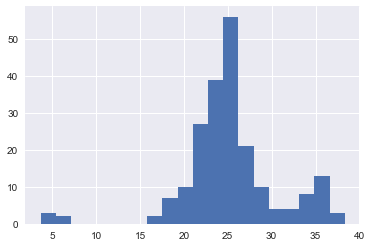

In [28]:
plt.hist(df2['Average Speed'],bins=20)

It is related to binomial distribution.

(array([16., 38., 23., 30., 20., 12.,  8., 20., 22., 11.,  3.,  1.,  2.,
         1.,  0.,  0.,  0.,  0.,  1.,  1.]),
 array([  0.     ,  20.60355,  41.2071 ,  61.81065,  82.4142 , 103.01775,
        123.6213 , 144.22485, 164.8284 , 185.43195, 206.0355 , 226.63905,
        247.2426 , 267.84615, 288.4497 , 309.05325, 329.6568 , 350.26035,
        370.8639 , 391.46745, 412.071  ]),
 <a list of 20 Patch objects>)

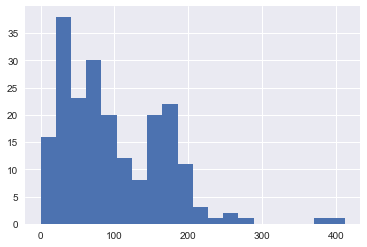

In [29]:
plt.hist(df2['TSS'],bins=20)

What we can see from the above that TSS is left skewed as more points are towards the left.

In [10]:
df1=df2[['distance','Time Moving','Average Speed','NP','TSS','Elevation Gain','Average Heart Rate','Average Power']]
df1.corr()

,distance,Time Moving,Average Speed,NP,TSS,Elevation Gain,Average Heart Rate,Average Power
distance,1.000000,0.933596,0.187363,0.270703,0.922565,0.805468,0.175241,0.129199
Time Moving,0.933596,1.000000,-0.112951,0.034142,0.866093,0.811409,0.039877,-0.119617
Average Speed,0.187363,-0.112951,1.000000,0.674857,0.134054,-0.016160,0.422165,0.814403
NP,0.270703,0.034142,0.674857,1.000000,0.432286,0.229933,0.343179,0.844487
TSS,0.922565,0.866093,0.134054,0.432286,1.000000,0.828928,0.183747,0.225290
Elevation Gain,0.805468,0.811409,-0.016160,0.229933,0.828928,1.000000,0.050890,-0.035987
Average Heart Rate,0.175241,0.039877,0.422165,0.343179,0.183747,0.050890,1.000000,0.448912
Average Power,0.129199,-0.119617,0.814403,0.844487,0.225290,-0.035987,0.448912,1.000000


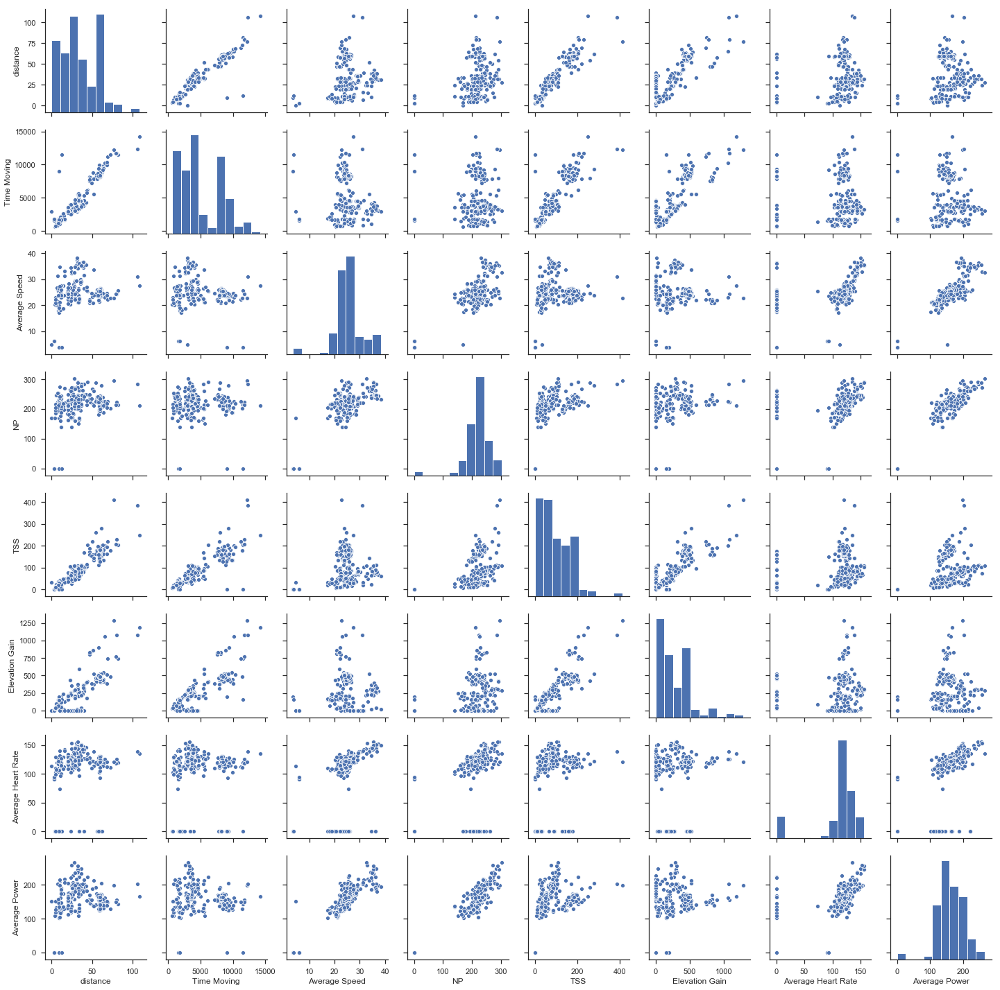

In [11]:
import seaborn as ss; ss.set(style="ticks",color_codes=True)
CSF=df1
f=ss.pairplot(CSF)


We can draw conclusion from the above that there is a strong correlation between the variables.

In [35]:
select_color1=df2[(df2['workout_type']=='Race')]
select_color1.head()

,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-01-27 20:01:32+00:00,146.9,22.0,187.7,True,38.6,67,449.00 m,19,67,Race,...,0,0,0,0,0,0,0,245.365,0.91554,94.5787
2018-02-10 20:46:02+00:00,152.1,19.0,198.9,True,31.0,49,387.00 m,21,49,Race,...,0,0,0,0,0,0,0,244.500,0.91231,69.2902
2018-03-03 20:02:23+00:00,143.0,18.0,217.3,True,15.5,32,175.00 m,15,28,Race,...,0,0,0,0,0,0,0,270.462,1.00919,47.6412
2018-03-24 20:45:44+00:00,153.6,16.0,200.2,True,30.1,50,381.00 m,16,50,Race,...,0,0,0,0,0,0,0,240.085,0.89584,67.9698
2018-04-07 21:47:39+00:00,141.8,17.0,223.7,True,10.0,23,130.00 m,11,22,Race,...,0,0,0,0,0,0,0,275.057,1.02633,41.5492


In [36]:
select_color2=df2[(df2['workout_type']=='Ride')]
select_color2.head()

,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-01-27 19:39:49+00:00,120.6,21.0,153.4,True,7.6,17,95.00 m,4,17,Ride,...,0,0,0,0,0,0,0,222.856,0.83155,20.2257
2018-02-05 21:06:42+00:00,119.3,19.0,165.9,True,24.3,69,439.00 m,6,65,Ride,...,0,0,0,0,0,0,0,253.702,0.94665,98.3269
2018-02-07 06:59:05+00:00,124.8,20.0,151.0,True,47.1,144,890.00 m,10,134,Ride,...,0,0,0,0,0,0,0,232.644,0.86808,171.0780
2018-02-09 19:18:03+00:00,123.0,20.0,145.9,True,59.8,193,656.00 m,22,139,Ride,...,0,0,0,0,0,0,0,212.726,0.79375,147.7970
2018-02-10 20:21:37+00:00,103.9,17.0,134.9,True,7.8,19,92.00 m,8,18,Ride,...,0,0,0,0,0,0,0,192.117,0.71685,15.7590


In [37]:
select_color3=df2[(df2['workout_type']=='Workout')]
select_color3.head()

,average_heartrate,average_temp,average_watts,device_watts,distance,elapsed_time,elevation_gain,kudos,moving_time,workout_type,...,Rest AVNN,Rest SDNN,Rest rMSSD,Rest PNN50,Rest LF,Rest HF,HRV Recovery Points,NP,IF,TSS
2018-05-13 20:44:30+00:00,114.8,14.0,164.2,True,0.0,52,0.00 m,9,52,Workout,...,0,0,0,0,0,0,0,169.042,0.63075,33.3201
2018-05-21 20:34:30+00:00,138.5,11.0,188.2,True,28.3,59,0.00 m,8,59,Workout,...,0,0,0,0,0,0,0,239.275,0.89282,76.5235
2018-05-28 20:47:42+00:00,135.4,10.0,185.6,True,28.9,60,0.00 m,7,60,Workout,...,0,0,0,0,0,0,0,223.167,0.83271,68.4551
2018-06-04 20:50:03+00:00,139.3,11.0,191.1,True,35.8,73,0.00 m,11,73,Workout,...,0,0,0,0,0,0,0,220.407,0.82242,80.7883
2018-08-01 20:41:09+00:00,125.0,10.0,161.0,True,22.0,52,0.00 m,6,52,Workout,...,0,0,0,0,0,0,0,182.578,0.68126,39.0891


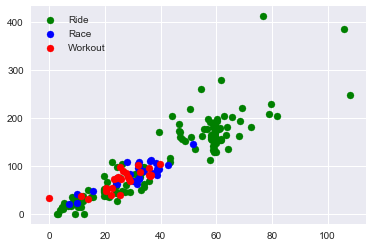

In [38]:
plt.scatter(select_color2["distance"],select_color2["TSS"],color='green', label="Ride")
plt.scatter(select_color1["distance"],select_color1["TSS"],color='blue', label="Race")
plt.scatter(select_color3["distance"],select_color3["TSS"],color='red',label="Workout")
plt.legend()
plt.show()

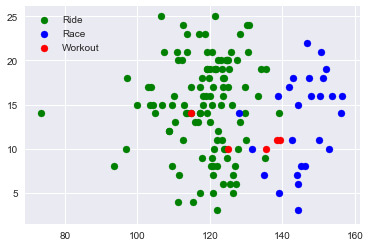

In [39]:
plt.scatter(select_color2["average_heartrate"],select_color2["average_temp"],color='green', label="Ride")
plt.scatter(select_color1["average_heartrate"],select_color1["average_temp"],color='blue', label="Race")
plt.scatter(select_color3["average_heartrate"],select_color3["average_temp"],color='red',label="Workout")
plt.legend()
plt.show()

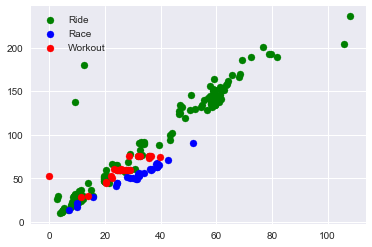

In [40]:
plt.scatter(select_color2["distance"],select_color2["moving_time"],color='green', label="Ride")
plt.scatter(select_color1["distance"],select_color1["moving_time"],color='blue', label="Race")
plt.scatter(select_color3["distance"],select_color3["moving_time"],color='red',label="Workout")
plt.legend()
plt.show()

From the above graphs, we can see that the distance is highly correlated with both TSS and moving time. There is no relationship between the average heartrate and average temperature 

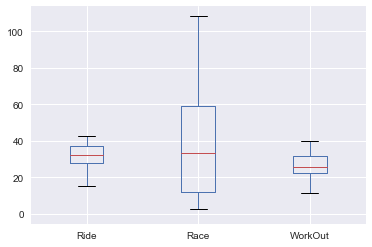

In [41]:
pf=pd.concat([select_color1['Distance'],select_color2['Distance'],select_color3['Distance']], axis=1, keys=['Ride', 'Race','WorkOut'])
pf.boxplot()
plt.show()

It is positively correlated

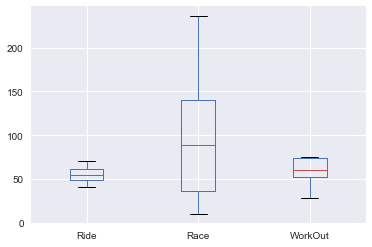

In [43]:
cd=pd.concat([select_color1['moving_time'],select_color2['moving_time'],select_color3['moving_time']], axis=1, keys=['Ride', 'Race','WorkOut'])
cd.boxplot()
plt.show()

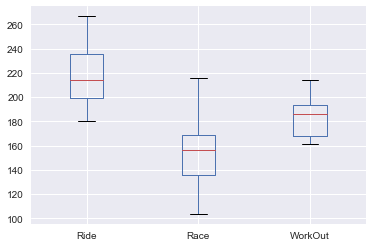

In [44]:
de=pd.concat([select_color1['average_watts'],select_color2['average_watts'],select_color3['average_watts']], axis=1, keys=['Ride', 'Race','WorkOut'])
de.boxplot()
plt.show()

In [45]:
kudos_corr=[df2[df2.columns[1:]].corr()['kudos'][:]]
kudos_corr_df = pd.DataFrame(kudos_corr)
kudos_corr_df=kudos_corr_df.loc[:,kudos_corr_df.gt(0.7).any()]
kudos_corr_df

,distance,kudos,Distance,Work,Aerobic TISS,P6 Time in Pace Zone,Distance Swim,L7 Time in Zone,TRIMP Zonal Points,W' Work,W2 W'bal Moderate Fatigue
kudos,0.753808,1.0,0.753892,0.709186,0.757963,0.714247,0.753892,0.713232,0.7357,0.728751,0.702678


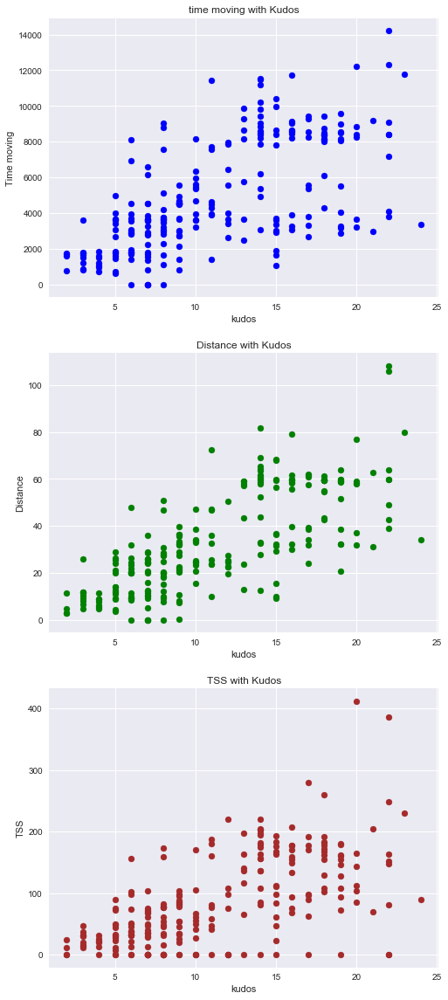

In [46]:
figure,axis=plt.subplots(3,1,figsize=(8,20))

#Kudos relationship with Time moving
axis[0].scatter(result['kudos'], result['Time Moving'], color='b')
axis[0].set_xlabel('kudos')
axis[0].set_ylabel('Time moving')
axis[0].set_title('time moving with Kudos')

#Kudos relationship with distance
axis[1].scatter(result['kudos'], result['Distance'], color='g')
axis[1].set_xlabel('kudos')
axis[1].set_ylabel('Distance')
axis[1].set_title('Distance with Kudos')

#Kudos relationship with TSS
axis[2].scatter(result['kudos'], result['TSS'], color='brown')
axis[2].set_xlabel('kudos')
axis[2].set_ylabel('TSS')
axis[2].set_title('TSS with Kudos')
plt.show()

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
import seaborn as sns
import matplotlib.pylab as plt
%matplotlib inline

In [3]:
# Read dataset
df = pd.read_csv('Appliances-energy-prediction-data/energydata_complete.csv')


In [5]:
df.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [48]:
df['date'].head()


0    2016-01-11 17:00:00
1    2016-01-11 17:10:00
2    2016-01-11 17:20:00
3    2016-01-11 17:30:00
4    2016-01-11 17:40:00
Name: date, dtype: object

In [49]:
df['date'] = pd.to_datetime(df['date'])
df['date'].head()

0   2016-01-11 17:00:00
1   2016-01-11 17:10:00
2   2016-01-11 17:20:00
3   2016-01-11 17:30:00
4   2016-01-11 17:40:00
Name: date, dtype: datetime64[ns]

The following plots are related to some of the plots shown in the paper 

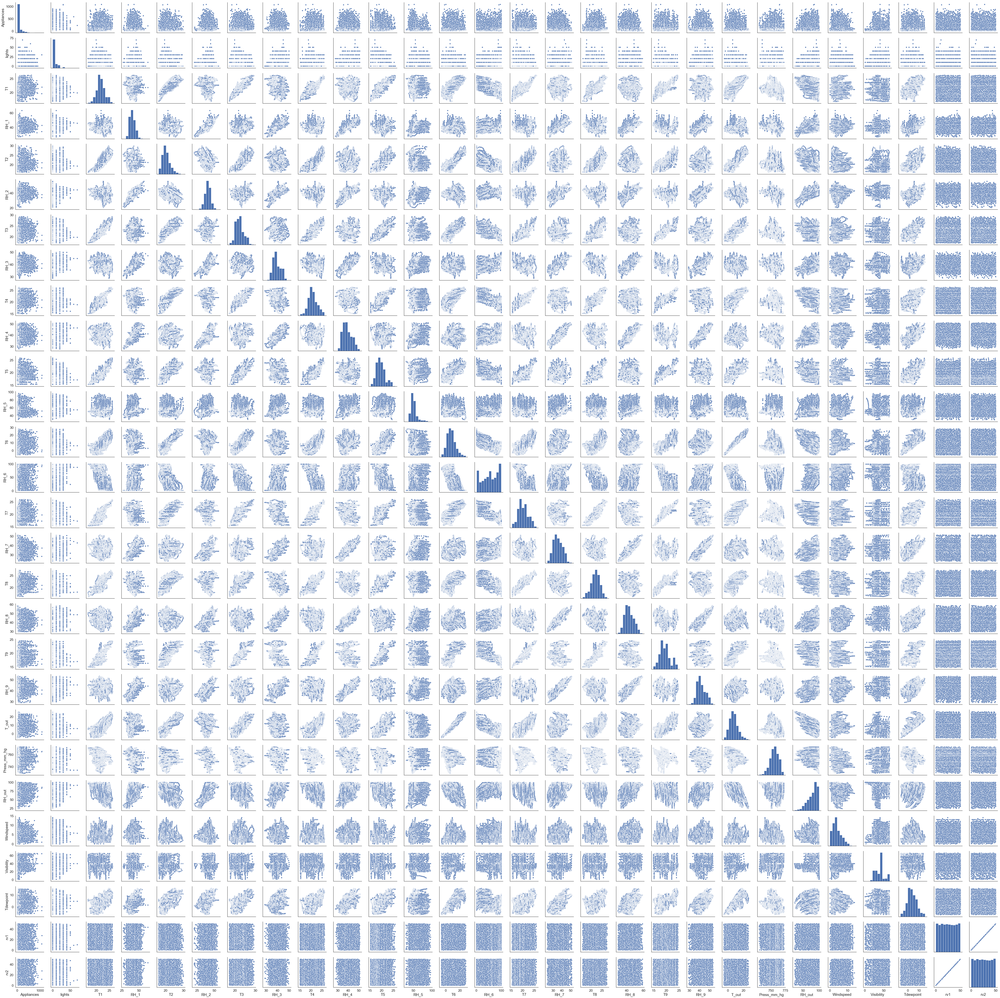

In [55]:
g=sns.pairplot(df)

Text(0.5, 0, 'Appliances in Wh')

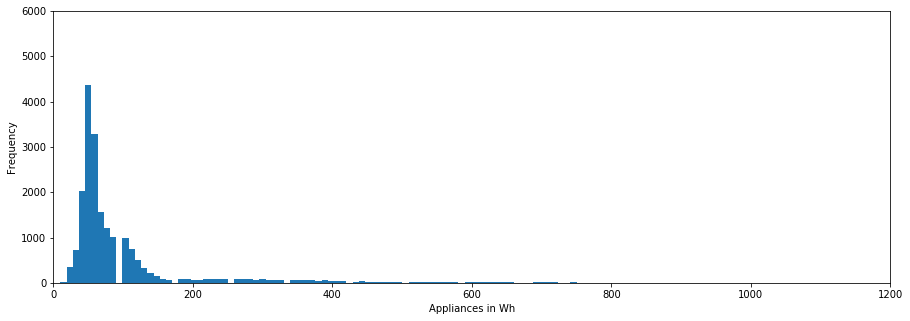

In [8]:
df['Appliances'].plot.hist(ylim=(0,6000),xlim=(0,1200),figsize=(15,5),bins=120)
plt.xlabel('Appliances in Wh')

Text(0, 0.5, 'Frequency')

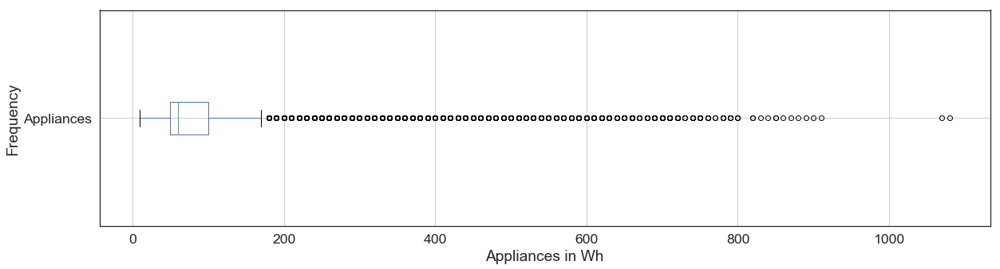

In [57]:
df1 =df.boxplot(column=['Appliances'],vert=False,figsize=(20,5))
df1.set_xlabel("Appliances in Wh")
df1.set_ylabel("Frequency")

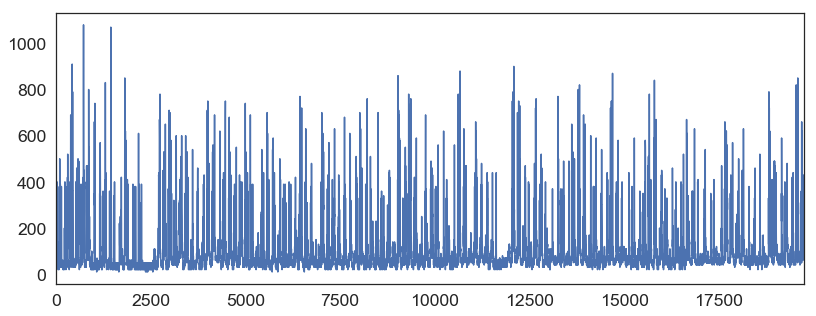

In [58]:
plt.figure(figsize = (13.4,5))
df['Appliances'].plot()

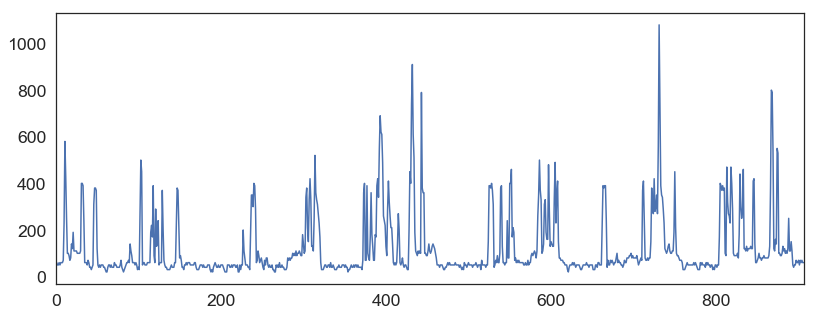

In [59]:
plt.figure(figsize = (13.4,5))
Appweek = df.loc[(df.date >= '2016-01-11') & (df.date <= '2016-01-18')]
Appweek['Appliances'].plot()

# Hourly energy consumption of appliances heat map for four consecutive weeks.


# Creating New Columns in energy data of weekday name and hour¶


In [60]:
df['date_day_name'] = df['date'].dt.weekday_name
df['date_hour'] = df['date'].dt.hour

## Slicing the dataframe into different dataframes based on months

In [61]:
MonthOne = df.loc[(df.date >= '2016-01-01') & (df.date <= '2016-01-28')]
MonthTwo = df.loc[(df.date >= '2016-02-01') & (df.date <= '2016-02-28')]
MonthThree = df.loc[(df.date >= '2016-03-01') & (df.date <= '2016-03-28')]
MonthFour = df.loc[(df.date >= '2016-04-01') & (df.date <= '2016-04-28')]

## Making a pivot table with day name and hour over appliances

In [71]:
MonthOne2 = pd.pivot_table(MonthOne[['date_day_name','date_hour','Appliances']],index=['date_day_name','date_hour'],aggfunc='sum')
MonthTwo2 = pd.pivot_table(MonthTwo[['date_day_name','date_hour','Appliances']],index=['date_day_name','date_hour'],aggfunc='sum')
MonthThree2 = pd.pivot_table(MonthThree[['date_day_name','date_hour','Appliances']],index=['date_day_name','date_hour'],aggfunc='sum')
MonthFour2 = pd.pivot_table(MonthFour[['date_day_name','date_hour','Appliances']],index=['date_day_name','date_hour'],aggfunc='sum')

## Unstacking the Dataframes

In [72]:
MonthOne3 = MonthOne2.unstack(level=0)
MonthTwo3 = MonthTwo2.unstack(level=0)
MonthThree3 = MonthThree2.unstack(level=0)
MonthFour3 = MonthFour2.unstack(level=0)

# Reindexing the labels in order

In [73]:
MonthOne3 = MonthOne3.reindex(labels=['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'],axis=1,level=1)
MonthTwo3 = MonthTwo3.reindex(labels=['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'],axis=1,level=1)
MonthThree3 = MonthThree3.reindex(labels=['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'],axis=1,level=1)
MonthFour3 = MonthFour3.reindex(labels=['Sunday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday'],axis=1,level=1)


In [74]:
day_short_names = ['Sun','Mon','Tues','Wed','Thurs','Fri','Sat'] 

[Text(16.5, 0.5, 'Hour of Day'), Text(0.5, 106.5, 'Day of the Week')]

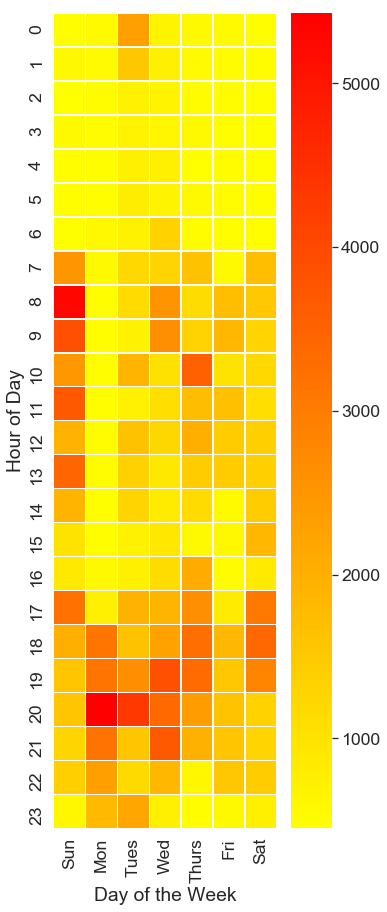

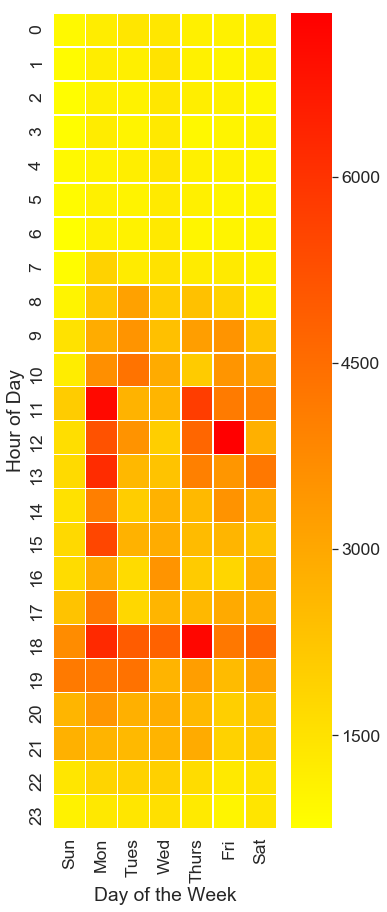

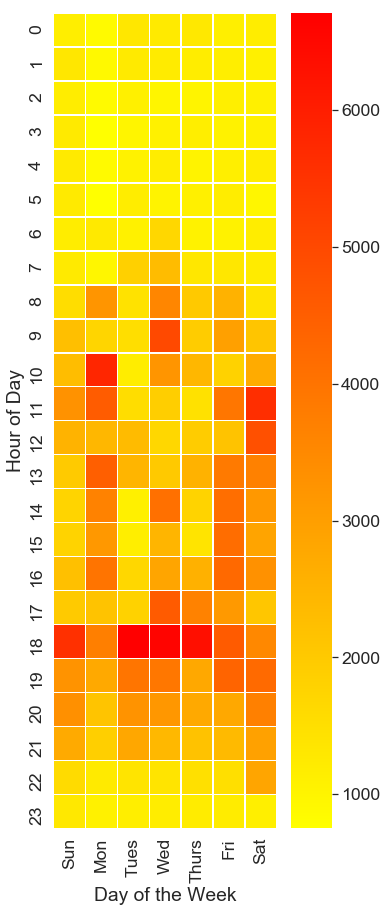

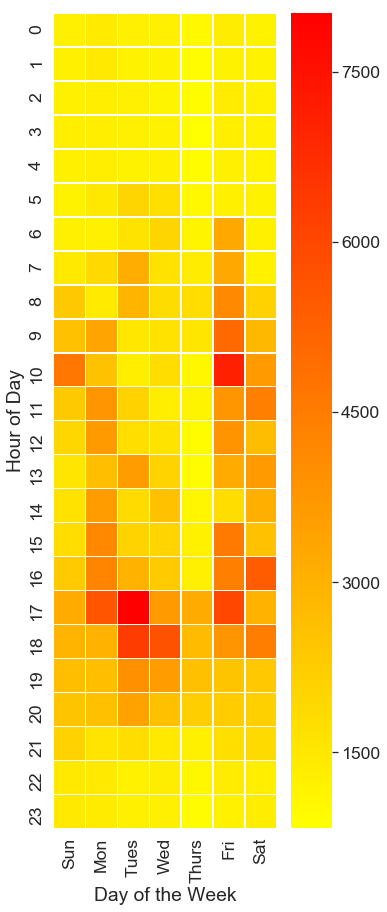

In [75]:
f,ax =plt.subplots(figsize=(5,15))
ax=sns.heatmap(MonthOne3,cmap="autumn_r",linewidths=.5, xticklabels=day_short_names)
ax.set(xlabel = 'Day of the Week',ylabel='Hour of Day')

f,bx =plt.subplots(figsize=(5,15))
bx=sns.heatmap(MonthTwo3,cmap="autumn_r",linewidths=.5, xticklabels=day_short_names)
bx.set(xlabel = 'Day of the Week',ylabel='Hour of Day')

f,cx =plt.subplots(figsize=(5,15))
cx=sns.heatmap(MonthThree3,cmap="autumn_r",linewidths=.5, xticklabels=day_short_names)
cx.set(xlabel = 'Day of the Week',ylabel='Hour of Day')

f,dx =plt.subplots(figsize=(5,15))
dx=sns.heatmap(MonthFour3,cmap="autumn_r",linewidths=.5, xticklabels=day_short_names)
dx.set(xlabel = 'Day of the Week',ylabel='Hour of Day')

## Pair plot


In [12]:
pairplot1 = df[['Appliances','lights','T1','RH_1','T2','RH_2','T3','RH_3']]
pairplot2 = df[['Appliances','T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6']]
pairplot3 = df[['Appliances','T7', 'RH_7', 'T8','RH_8', 'T9', 'RH_9']]
pairplot4 = df[['Appliances','T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2']]

NameError: name 'stats' is not defined

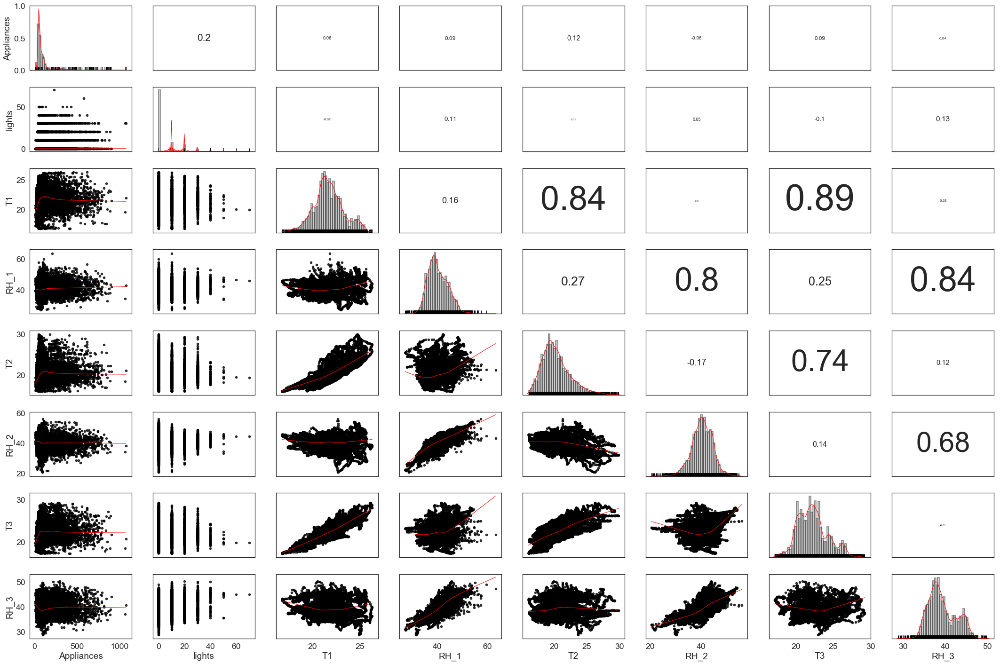

In [13]:
def corrdot(*args, **kwargs):
    corr_r = args[0].corr(args[1], 'pearson')
    corr_text = round(corr_r, 2)
    ax = plt.gca()
    font_size = abs(corr_r) * 80 + 5
    ax.annotate(corr_text, [.5, .5,],  xycoords="axes fraction",
                ha='center', va='center', fontsize=font_size)

def corrfunc(x, y, **kws):
    r, p = stats.pearsonr(x, y)
    p_stars = ''
    if p <= 0.05:
        p_stars = '*'
    if p <= 0.01:
        p_stars = '**'
    if p <= 0.001:
        p_stars = '***'
    ax = plt.gca()
    ax.annotate(p_stars, xy=(0.65, 0.6), xycoords=ax.transAxes,
                color='red', fontsize=70)

sns.set(style='white', font_scale=1.6)
g = sns.PairGrid(pairplot1, aspect=1.5, diag_sharey=False, despine=False)
g.map_lower(sns.regplot, lowess=True, ci=False,
            line_kws={'color':'red', 'lw': 1},
            scatter_kws={'color':'black', 's': 20})
g.map_diag(sns.distplot, color='black',
           kde_kws={'color':'red', 'cut': 0.7, 'lw': 1},
           hist_kws={'histtype':'bar', 'lw': 2,
                     'edgecolor': 'k', 'facecolor':'grey'})
g.map_diag(sns.rugplot, color='black')
g.map_upper(corrdot)
g.map_upper(corrfunc)
g.fig.subplots_adjust(wspace=0, hspace=0)

# Remove axis labels
for ax in g.axes.flatten():
    ax.set_ylabel('')
    ax.set_xlabel('')

# Add titles to the diagonal axes/subplots
for ax, col in zip(np.diag(g.axes), pairplot1.columns):
    ax.set_title(col, y=0.82, fontsize=26)

In [ ]:
sns.set(style='white', font_scale=1.6)
g = sns.PairGrid(pairplot2, aspect=1.5, diag_sharey=False, despine=False)
g.map_lower(sns.regplot, lowess=True, ci=False,
            line_kws={'color':'red', 'lw': 1},
            scatter_kws={'color':'black', 's': 20})
g.map_diag(sns.distplot, color='black',
           kde_kws={'color':'red', 'cut': 0.7, 'lw': 1},
           hist_kws={'histtype':'bar', 'lw': 2,
                     'edgecolor': 'k', 'facecolor':'grey'})
g.map_diag(sns.rugplot, color='black')
g.map_upper(corrdot)
g.map_upper(corrfunc)
g.fig.subplots_adjust(wspace=0, hspace=0)

# Remove axis labels
for ax in g.axes.flatten():
    ax.set_ylabel('')
    ax.set_xlabel('')

# Add titles to the diagonal axes/subplots
for ax, col in zip(np.diag(g.axes), pairplot2.columns):
    ax.set_title(col, y=0.82, fontsize=26)

In [ ]:
sns.set(style='white', font_scale=1.6)
g = sns.PairGrid(pairplot3, aspect=1.5, diag_sharey=False, despine=False)
g.map_lower(sns.regplot, lowess=True, ci=False,
            line_kws={'color':'red', 'lw': 1},
            scatter_kws={'color':'black', 's': 20})
g.map_diag(sns.distplot, color='black',
           kde_kws={'color':'red', 'cut': 0.7, 'lw': 1},
           hist_kws={'histtype':'bar', 'lw': 2,
                     'edgecolor': 'k', 'facecolor':'grey'})
g.map_diag(sns.rugplot, color='black')
g.map_upper(corrdot)
g.map_upper(corrfunc)
g.fig.subplots_adjust(wspace=0, hspace=0)

# Remove axis labels
for ax in g.axes.flatten():
    ax.set_ylabel('')
    ax.set_xlabel('')

# Add titles to the diagonal axes/subplots
for ax, col in zip(np.diag(g.axes), pairplot3.columns):
    ax.set_title(col, y=0.82, fontsize=26)

Now, we will fit a linear regression model

Preparation of data

In [63]:
reg = linear_model.LinearRegression()
X = df[['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2']]
y = df['Appliances']
reg.fit(X, y)
print("y = x *", reg.coef_, "+", reg.intercept_)

y = x * [ 1.98970872e+00 -6.03740447e-01  1.51536202e+01 -1.77060184e+01
 -1.34806196e+01  2.54063968e+01  4.92457103e+00 -3.46525259e+00
 -1.78907733e-01 -2.78433827e-02  1.40960661e-01  7.12616274e+00
  2.87947692e-01  1.79462806e+00 -1.54968445e+00  8.14656214e+00
 -4.66967684e+00 -1.58724297e+01 -9.01020672e-01 -1.02281901e+01
  1.39856191e-01 -1.06374667e+00  1.70363647e+00  1.53681019e-01
  5.04880144e+00 -2.07763425e-02 -2.07763425e-02] + 50.20843659687881


In [64]:
predicted = reg.predict(X)
mse = ((np.array(y)-predicted)**2).sum()/len(y)
r2 = r2_score(y, predicted)
print("MSE:", mse)
print("R Squared:", r2)

MSE: 8777.519929754459
R Squared: 0.16490630926307803


This model isn't good, as R Squared value is small.

In [14]:
feature_cols = np.array(['lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3',
       'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8',
       'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed',
       'Visibility', 'Tdewpoint', 'rv1', 'rv2'])
X = df[feature_cols]
y = df['Appliances']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [15]:
from sklearn.feature_selection import RFE

estimator = LinearRegression()
selector = RFE(estimator, 10)  # select 3 features for us
selector = selector.fit(X, y)

supp = selector.get_support()
print("Selected features:", feature_cols[supp])
print("Coeffs:", selector.estimator_.coef_)
# test the model
predicted = selector.predict(X)
print("MSE:", mean_squared_error(y, predicted))
print("R^2:", r2_score(y, predicted))

Selected features: ['RH_1' 'T2' 'RH_2' 'T3' 'RH_3' 'T6' 'T8' 'RH_8' 'T9' 'T_out']
Coeffs: [ 16.37517994 -17.40318129 -13.227131    24.41530018   4.81272642
   6.38172042  11.56871264  -6.49235308 -24.45405809  -5.35418454]
MSE: 9039.230787528333
R^2: 0.14000712499766288


T2 is the best feature, as it has the largest coefficient.

# Portfolio 3 - Clustering Visualisation

K-means clustering is one of the simplest and popular unsupervised learning algorithms. Typically, unsupervised algorithms make inferences from datasets using only input vectors without referring to known, or labelled, outcomes. This notebook illustrates the process of K-means clustering by generating some random clusters of data and then showing the iterations of the algorithm as random cluster means are updated. 

We first generate random data around 4 centers.

In [2]:
import numpy as np 
import pandas as pd 
from matplotlib import pyplot as plt
%matplotlib inline

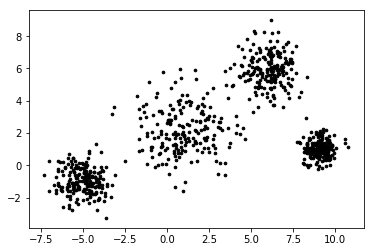

In [3]:
center_1 = np.array([1,2])
center_2 = np.array([6,6])
center_3 = np.array([9,1])
center_4 = np.array([-5,-1])

# Generate random data and center it to the four centers each with a different variance
np.random.seed(5)
data_1 = np.random.randn(200,2) * 1.5 + center_1
data_2 = np.random.randn(200,2) * 1 + center_2
data_3 = np.random.randn(200,2) * 0.5 + center_3
data_4 = np.random.randn(200,2) * 0.8 + center_4

data = np.concatenate((data_1, data_2, data_3, data_4), axis = 0)

plt.scatter(data[:,0], data[:,1], s=7, c='k')
plt.show()

## 1. Generate random cluster centres

You need to generate four random centres.

This part of portfolio should contain at least:  
- The number of clusters `k` is set to 4;
- Generate random centres via `centres = np.random.randn(k,c)*std + mean` where `std` and `mean` are the standard deviation and mean of the data. `c` represents the number of features in the data. Set the random seed to 6.
- Color the generated centers with `green`, `blue`, `yellow`, and `cyan`. Set the edgecolors to `red`.

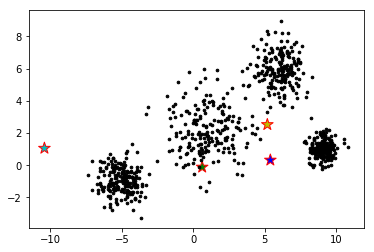

In [5]:
k = 4
# Number of training data
n = data.shape[0]
# Number of features in the data
c = data.shape[1]

# Generate random centers, here we use sigma and mean to ensure it represent the whole data
np.random.seed()
mean = np.mean(data, axis = 0)
std = np.std(data, axis = 0)
centers = np.random.randn(k,c)*std + mean

# Plot the data and the centers generated as random

plt.scatter(centers[:,0], centers[:,1], marker='*', c=['g','b','y','c'], s=150,edgecolor="r")
plt.scatter(data[:,0], data[:,1], s=7, c='k')


## 2. Visualise the clustering results in each iteration

You need to implement the process of k-means clustering.  Implement each iteration as a seperate cell, assigning each data point to the closest centre, then updating the cluster centres based on the data, then plot the new clusters.

Replace this text with your explaination of the algorithm.  The resulting notebook should provide a good explanation and demonstration of the K-means algorithm.

In [6]:
from copy import deepcopy

In [28]:
clusters=np.zeros(len(data)) #Creating a 1D array for storing the nearest cluster for each point.
clusters.shape

(800,)

In [29]:
# Function to find the distance between the point and the nearest centroid.
def distance(point, centroid, ax=1):
    return np.linalg.norm(point - centroid, axis=ax)

In [30]:
def find_cluster():
    for i in range(len(data)):    
        distances = distance(data[i],centers)  # Finding the distance between the points and the previous centres.
        cluster = np.argmin(distances)   # Finding the nearest  distance cluster.
        clusters[i] = cluster  #Assigning the Points to the nearest centroid/cluster.
        for i in range(k):
            datapoint=data[cluster==i]
        
        
#f, ax = plt.subplots(1)
#for i in np.unique(target):
#    mask = target == i
 #   plt.scatter(feats[mask, 0], feats[mask, 1], label=i)
#ax.legend()

In [34]:
# We want to find the new centres using the averages of the points which belong to the same cluster.
def find_centres():
    for r in range(k):
        pts=[data[j] for j in range(len(data)) if clusters[j]==r] # Grouping the points based on their cluster.
        centers[r]=np.mean(pts,axis=0)  # Updating the new Cluster centres.

In [35]:
find_cluster()
clusters

array([2., 3., 0., 2., 2., 0., 0., 2., 0., 0., 2., 0., 0., 2., 0., 2., 0.,
       0., 0., 0., 2., 0., 0., 0., 0., 0., 2., 0., 0., 0., 0., 2., 0., 2.,
       0., 0., 2., 2., 2., 0., 0., 0., 0., 0., 2., 2., 2., 0., 2., 0., 0.,
       0., 0., 0., 0., 2., 2., 2., 0., 0., 0., 2., 2., 2., 0., 2., 2., 0.,
       0., 0., 0., 2., 0., 0., 2., 0., 0., 0., 2., 0., 0., 0., 0., 0., 2.,
       2., 0., 0., 2., 2., 2., 0., 0., 2., 2., 0., 0., 0., 0., 0., 2., 2.,
       0., 0., 0., 2., 0., 2., 0., 2., 2., 0., 0., 0., 0., 2., 0., 0., 0.,
       2., 0., 2., 2., 0., 0., 0., 0., 0., 0., 0., 2., 2., 0., 0., 0., 0.,
       2., 2., 2., 2., 2., 0., 0., 0., 0., 2., 2., 2., 2., 2., 0., 0., 0.,
       2., 0., 0., 0., 2., 2., 2., 2., 0., 0., 0., 2., 2., 0., 0., 0., 2.,
       2., 2., 0., 0., 0., 0., 3., 0., 0., 2., 2., 0., 0., 2., 0., 2., 2.,
       0., 0., 2., 0., 0., 0., 2., 0., 2., 0., 0., 2., 0., 0., 3., 3., 3.,
       3., 3., 0., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 0., 3., 3.,
       3., 3., 3., 3., 3.

In [37]:
find_centres()
centers

array([[ 1.52209805,  3.65377169],
       [-5.19572532, -0.94215772],
       [ 0.33911773,  0.46235021],
       [ 7.78137297,  3.23567249]])

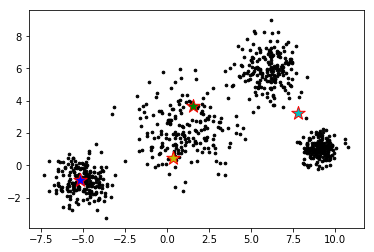

In [41]:
plt.scatter(data[:,0], data[:,1], s=7, c='k')
colo=['g','b','y','c']
for i in range(4):
   color=colo[i]
   plt.scatter(centers[i][0],centers[i][1],marker='*', s=200, c=color,edgecolor="red")


In [44]:
find_cluster()
find_centres()
centers

array([[ 2.19792717,  3.8317065 ],
       [-5.05717014, -0.94967031],
       [ 0.50946917,  1.35659691],
       [ 7.71899242,  3.34809173]])

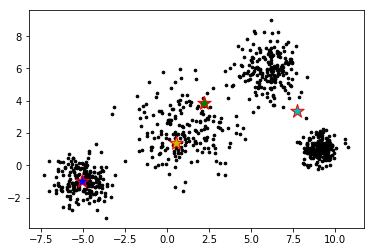

In [45]:
plt.scatter(data[:,0], data[:,1], s=7, c='k')
colo=['g','b','y','c']
for i in range(4):
   color=colo[i]
   plt.scatter(centers[i][0],centers[i][1],marker='*', s=200, c=color,edgecolor="red")

In [46]:
find_cluster()
find_centres()
centers

array([[ 2.92412523,  4.37767034],
       [-5.05717014, -0.94967031],
       [ 0.4946031 ,  1.53637857],
       [ 7.84463385,  3.20642109]])

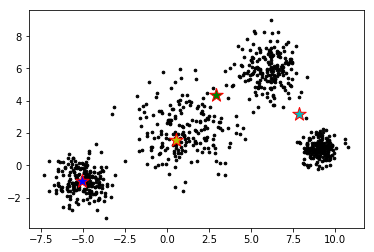

In [47]:
plt.scatter(data[:,0], data[:,1], s=7, c='k')
colo=['g','b','y','c']
for i in range(4):
   color=colo[i]
   plt.scatter(centers[i][0],centers[i][1],marker='*', s=200, c=color,edgecolor="red")

In [49]:
find_cluster()
find_centres()
centers

array([[ 4.08296449,  5.17589217],
       [-5.05717014, -0.94967031],
       [ 0.5781481 ,  1.72210425],
       [ 8.16192359,  2.78565647]])

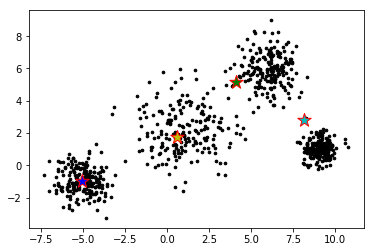

In [50]:
plt.scatter(data[:,0], data[:,1], s=7, c='k')
colo=['g','b','y','c']
for i in range(4):
   color=colo[i]
   plt.scatter(centers[i][0],centers[i][1],marker='*', s=200, c=color,edgecolor="red")

It can be observed that the centers are getting closer to the clusters in every iteration